##Data Normalization


importando as bibliotecas

In [1]:
import os

import cv2
import glob
import random
import imutils
import numpy as np
import skimage.io as io
import skimage.util
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

from PIL import Image
from imgaug import augmenters as iaa
from imutils.contours import sort_contours
from google.colab.patches import cv2_imshow

In [2]:
!git clone https://github.com/rraaffaa98/DATA_AUGMENTATION.git

Cloning into 'DATA_AUGMENTATION'...
remote: Enumerating objects: 214, done.
remote: Counting objects: 100% (108/108), done.
remote: Compressing objects: 100% (108/108), done.
remote: Total 214 (delta 1), reused 107 (delta 0), pack-reused 106
Receiving objects: 100% (214/214), 104.99 MiB | 19.84 MiB/s, done.
Resolving deltas: 100% (1/1), done.


In [3]:
classes = ['BEER', 'CAROT', 'CORN_CAN', 'EGG', 'MARGARINE', 'MAYONNAISE',
           'MILK', 'ONION', 'TOMATO_SAUCE', 'WINE']

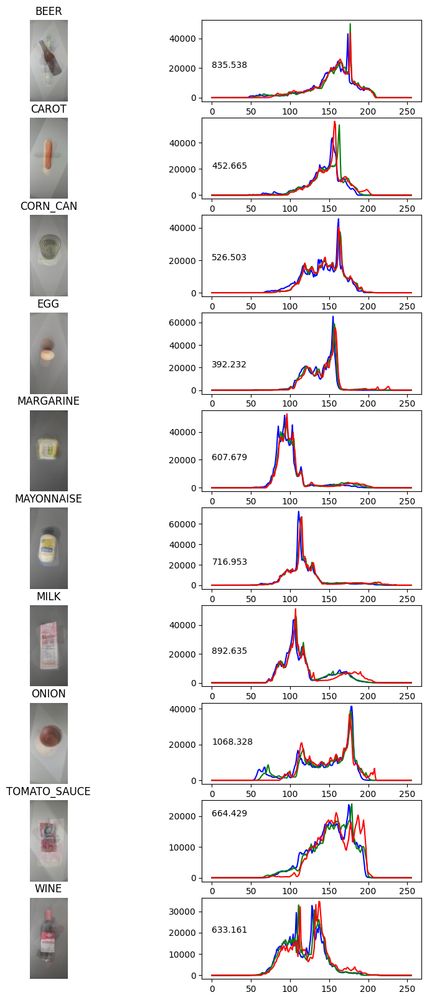

In [4]:
f, axs = plt.subplots(10, 2, figsize=(10, 20))
# acessando as classes e colocando na lista
i = 0
for classe in classes:
  pasta = f'/content/DATA_AUGMENTATION/{classe}/*.png'
  imagens_path = glob.glob(pasta)
  imagens = []

  for image_path in imagens_path:
    img = cv2.imread(image_path)
    imagens.append(img)

  # Plotando o protótipo de cada classe

  imagens = np.array(imagens)
  prototipo = np.uint8(np.average(imagens, axis=0))
  axs[i][0].imshow(cv2.cvtColor(prototipo, cv2.COLOR_BGR2RGB))
  axs[i][0].axis('off')
  axs[i][0].set_title(classe)

  # Plotar histograma de cada classe

  colors = ('b','g','r')
  var = np.var(prototipo)
  arredonda=round(var,3)
  #computando e plotando os histogramas
  for j, color in enumerate(colors):
      hist = cv2.calcHist([prototipo],[j],None,[256],[0,256])
      axs[i][1].plot(hist, color = color)
  axs[i][1].text(0, 20000, arredonda)
  i += 1

##SEGMENTATION

segmentando a imagem de forma manual

In [5]:
!git clone https://github.com/JuniorSolda/TRABALHO-PDI-GROUND-TRUTH.git

Cloning into 'TRABALHO-PDI-GROUND-TRUTH'...
remote: Enumerating objects: 63, done.
remote: Counting objects: 100% (1/1), done.
remote: Total 63 (delta 0), reused 0 (delta 0), pack-reused 62
Unpacking objects: 100% (63/63), 19.19 MiB | 11.67 MiB/s, done.


# BOUNDING BOX

In [6]:
def gt(imagem, idx, classe):
  #imagens = np.array(imagens)
  gray = cv2.cvtColor(imagem, cv2.COLOR_BGR2GRAY)
  gray[gray != 255] = 0

  contours, hierarchy = cv2.findContours(gray,cv2.RETR_LIST,cv2.CHAIN_APPROX_SIMPLE)[-2:]

  cv2.drawContours(imagem, contours, -1, 2)

  for cnt in contours:
      x,y,w,h = cv2.boundingRect(cnt)
      #para exibir a boundig box, colocar (0,255,0) como argumento em cv2.rectangle
      cv2.rectangle(imagem, (x,y), (x+w,y+h), 2)
      if w > 100 and h > 100:
        roi = imagem[y:y+h,x:x+w]
        res=cv2.resize(roi, dsize=(737,1600), interpolation=cv2.INTER_CUBIC)
        cv2.imwrite(f'/content/DATA_AUGMENTATION/{classe}/{str(idx)}.png', res)

  cv2_imshow(imagem)

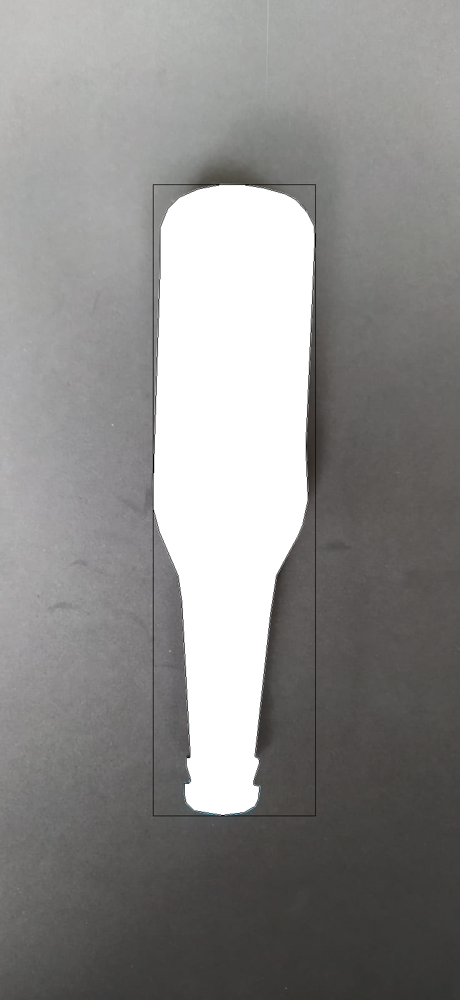

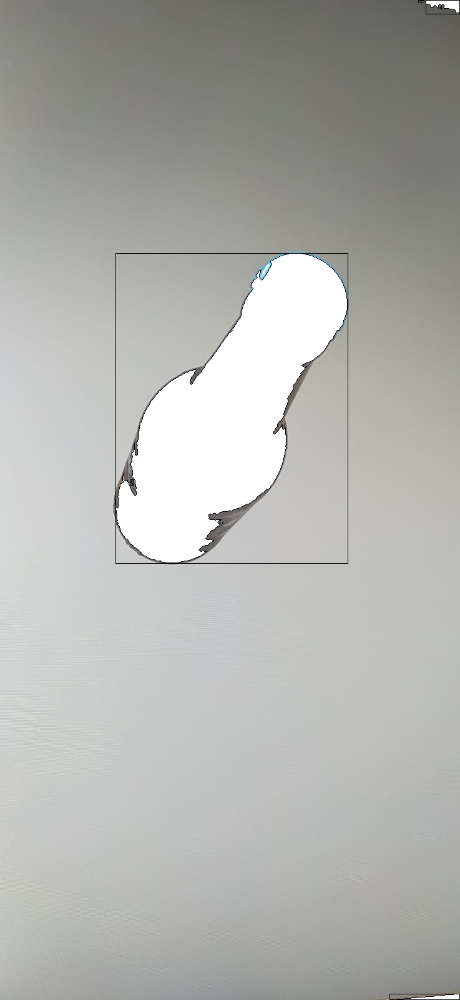

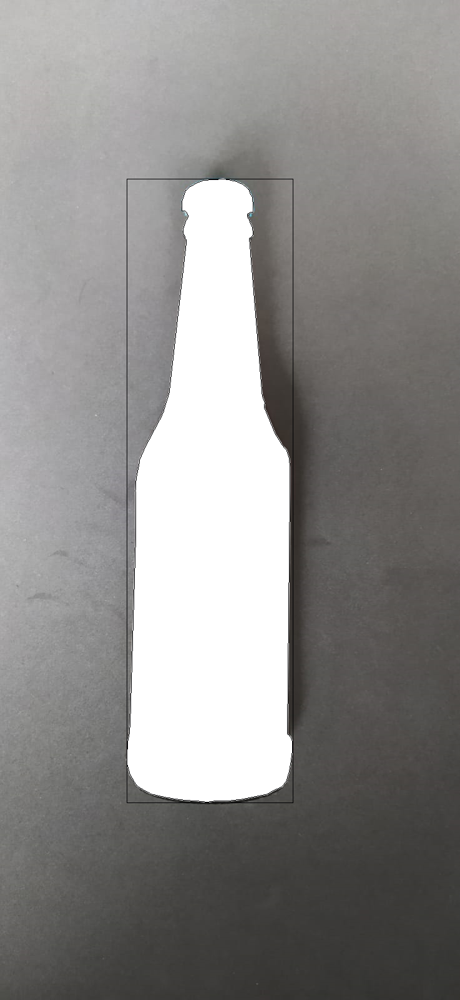

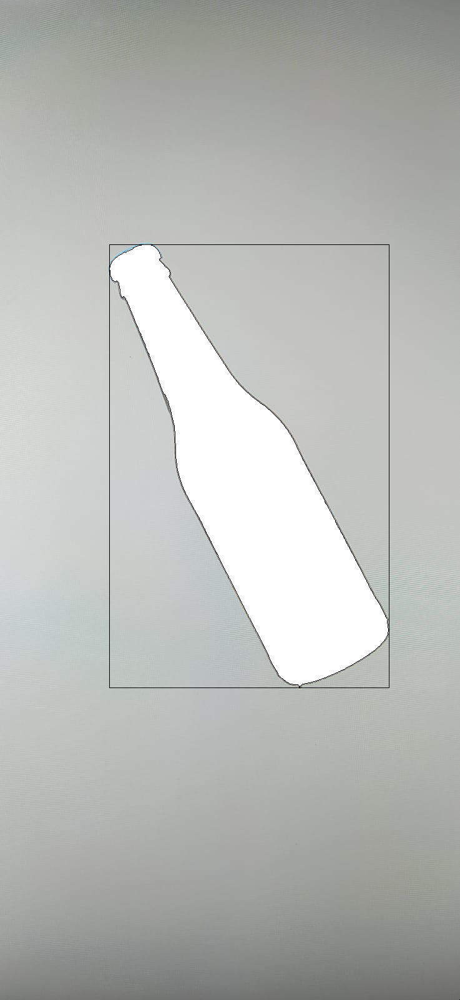

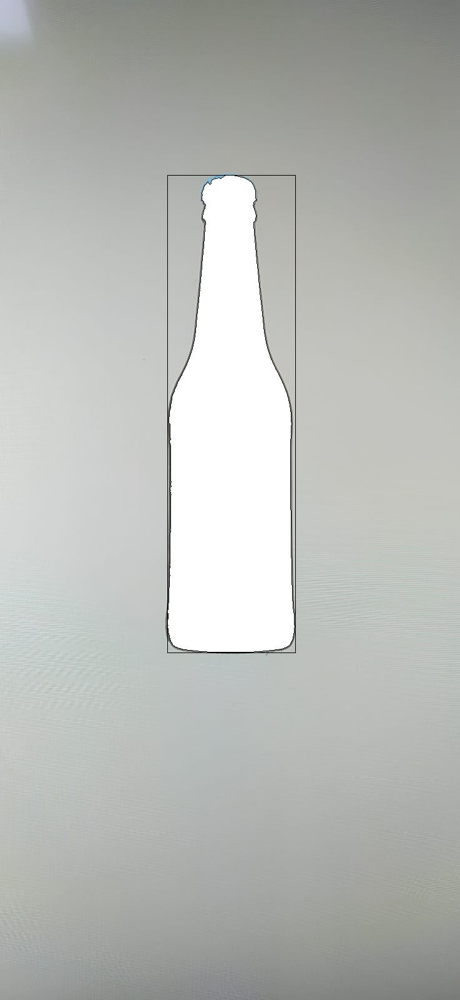

In [7]:
#BEER
beer01= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/BEER/0-01-V1-B-GT.png')
beer02= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/BEER/0-01-V1-W-GT.png')
beer03= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/BEER/0-01-V2-B-GT.png')
beer04= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/BEER/0-01-V2-W-GT.png')
beer05= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/BEER/0-02-V1-W-GT.png')


gt(beer01, 0, "BEER")
gt(beer02, 1, "BEER")
gt(beer03, 2, "BEER")
gt(beer04, 3, "BEER")
gt(beer05, 4, "BEER")


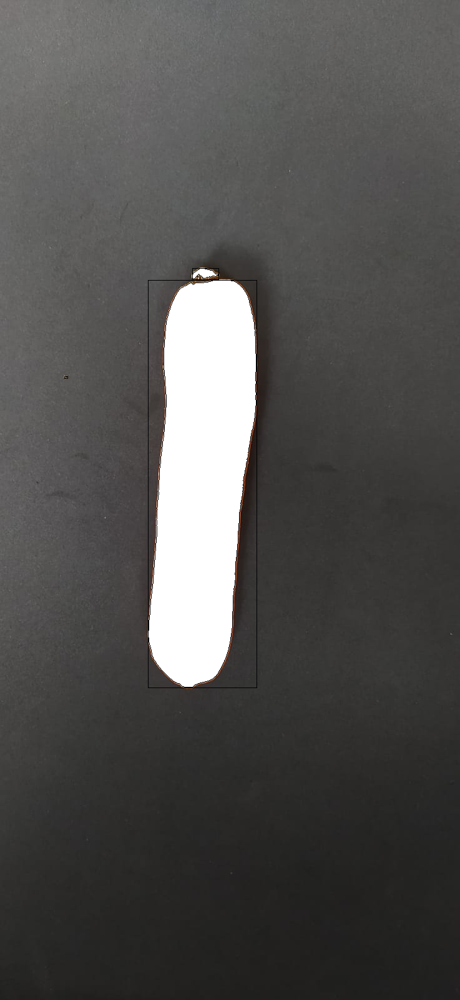

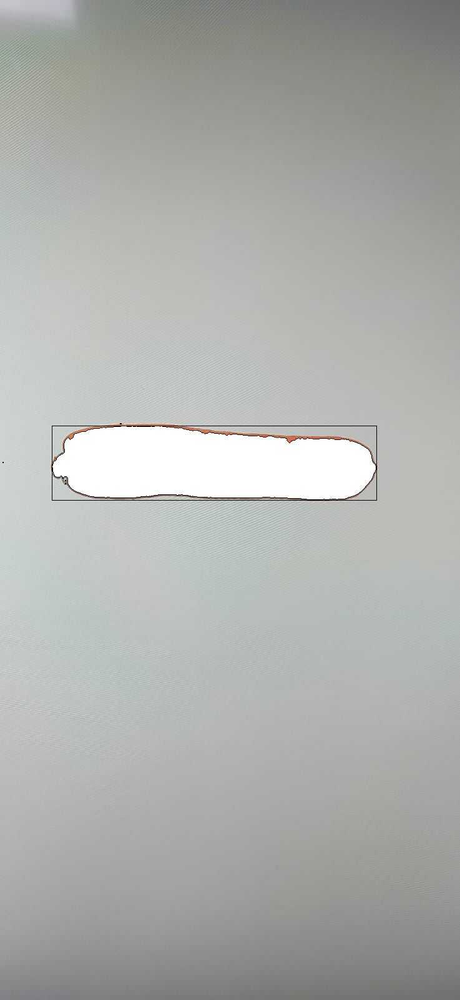

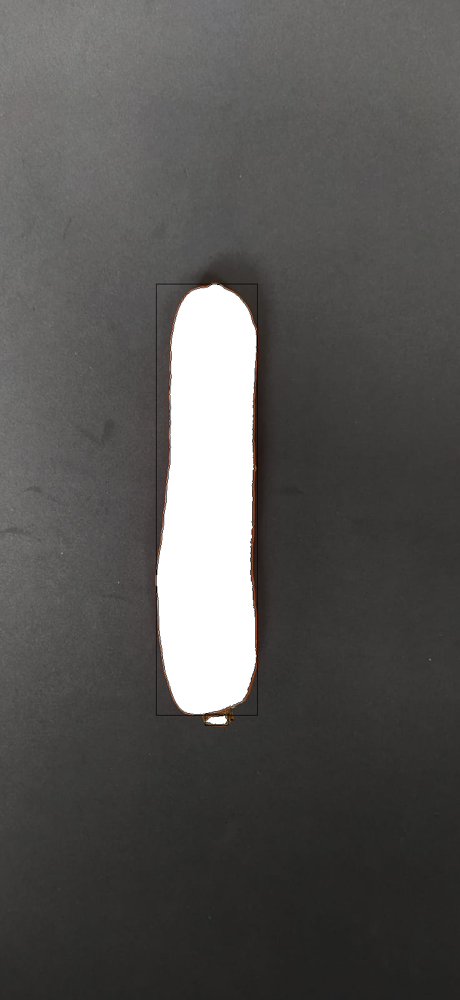

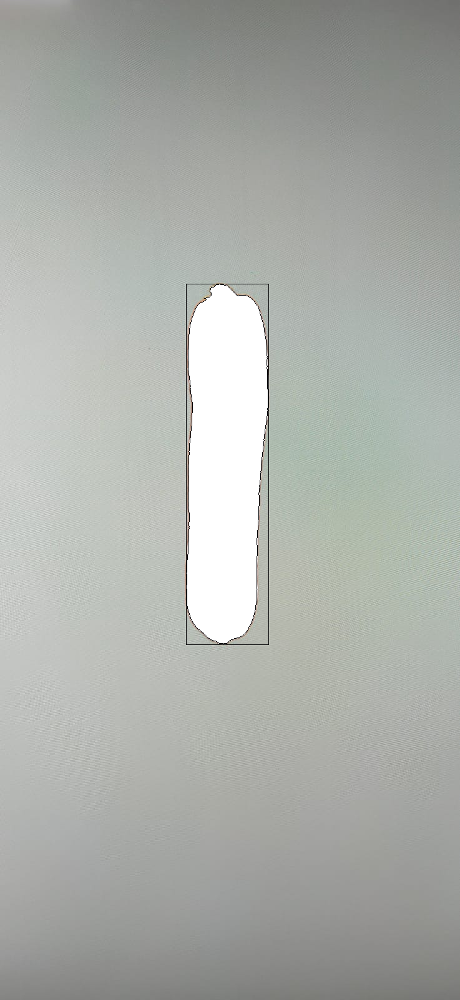

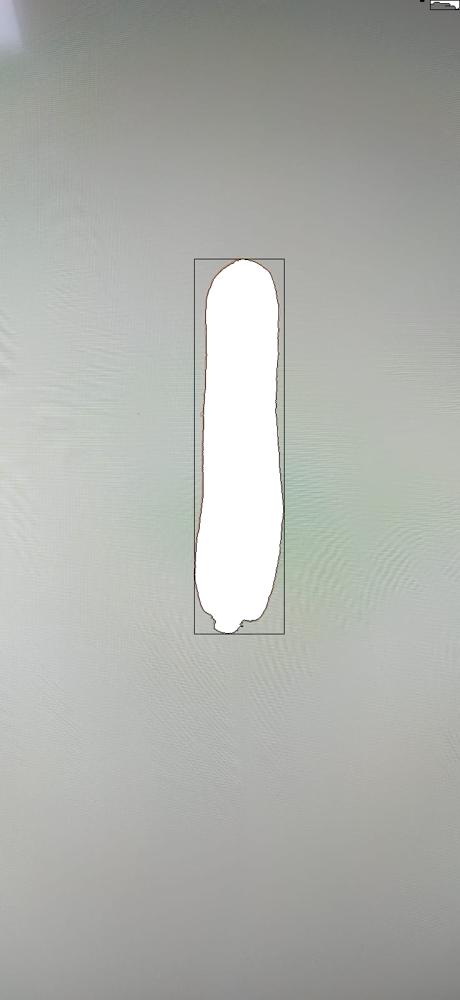

In [8]:
carot01= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/CAROT/1-01-V1-B-GT.png')
carot02= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/CAROT/1-01-V1-W-GT.png')
carot03= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/CAROT/1-01-V2-B-GT.png')
carot04= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/CAROT/1-01-V2-W-GT.png')
carot05= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/CAROT/1-02-V1-W-GT.png')

gt(carot01, 0, "CAROT")
gt(carot02, 1, "CAROT")
gt(carot03, 2, "CAROT")
gt(carot04, 3, "CAROT")
gt(carot05, 4, "CAROT")

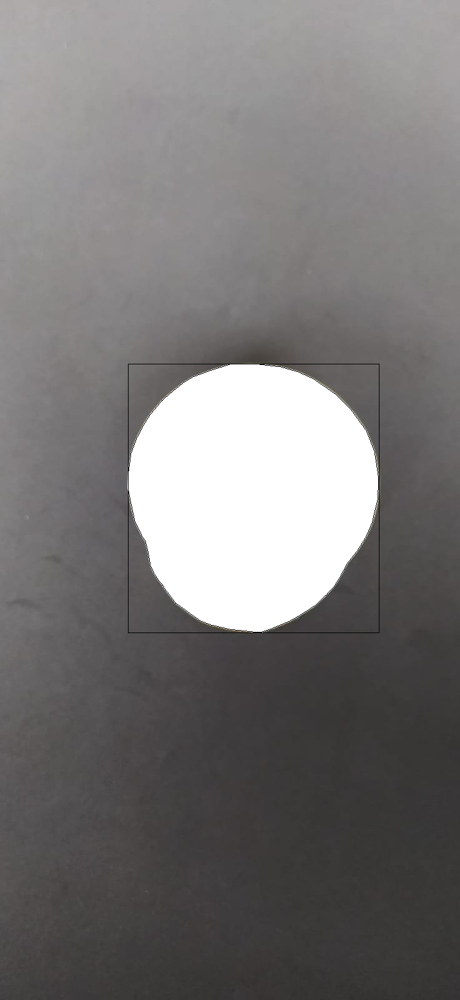

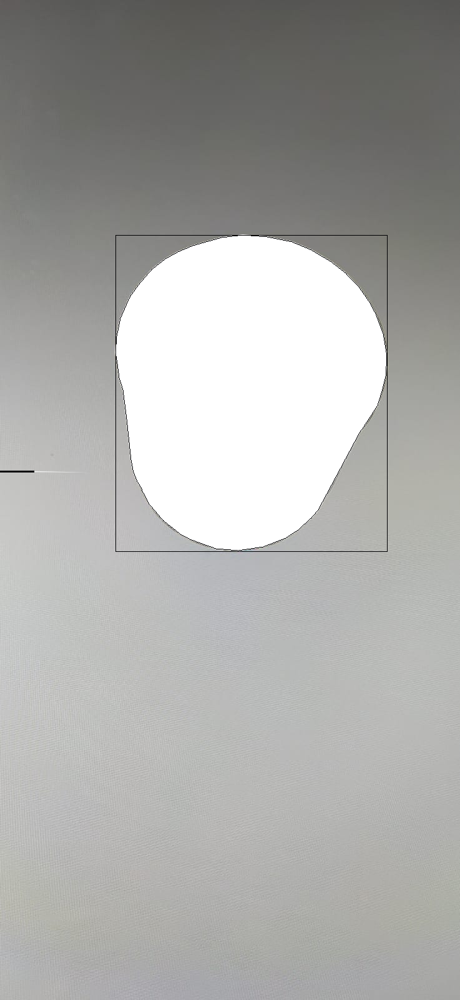

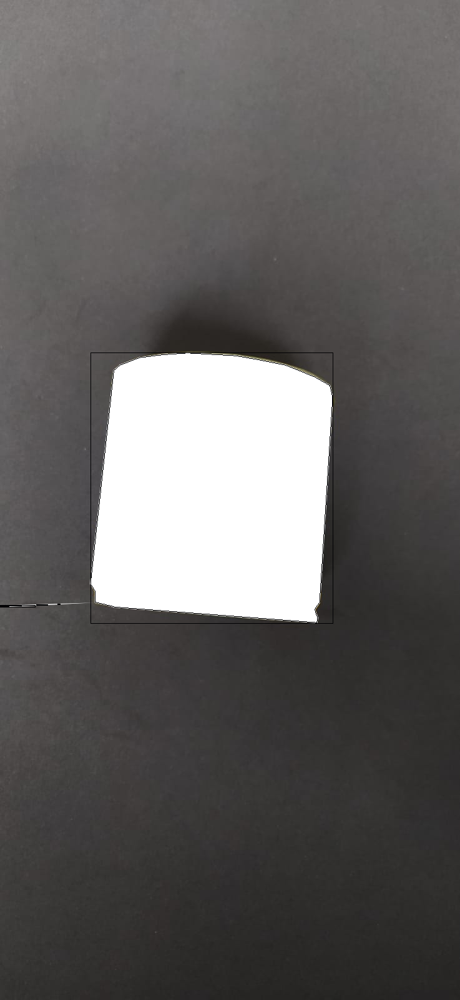

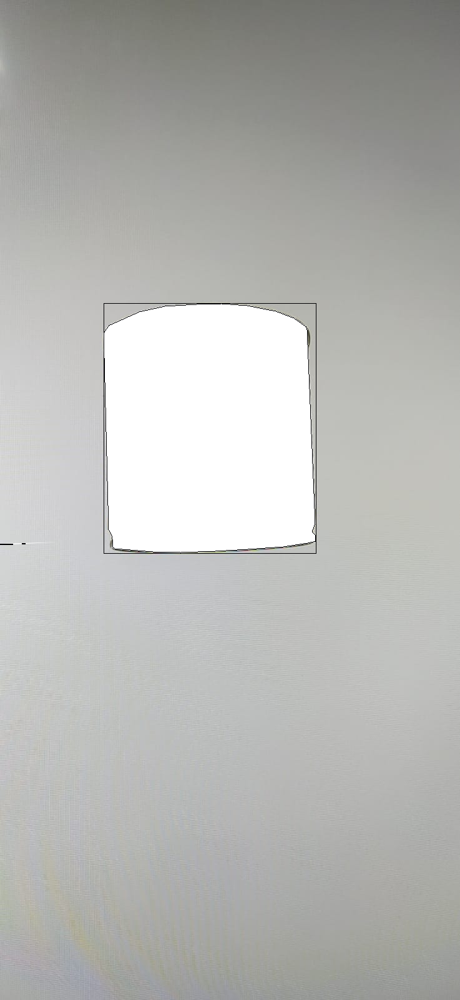

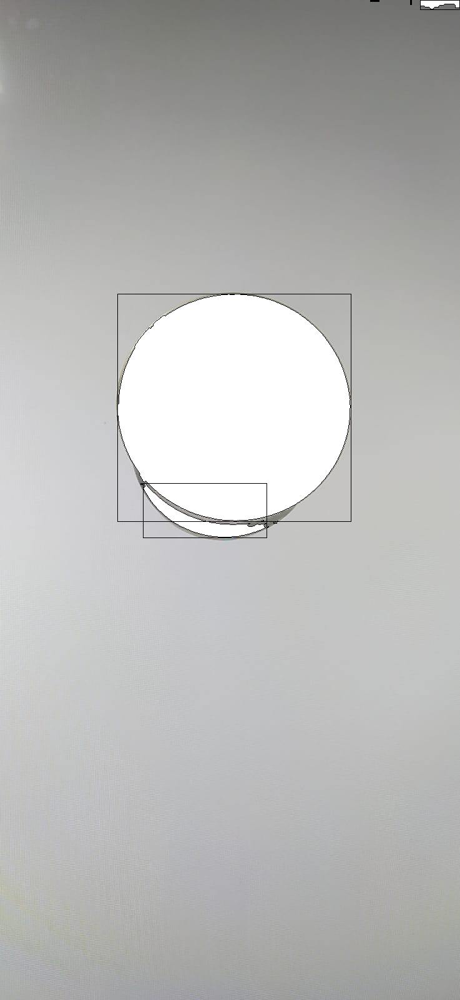

In [9]:
corn_can01= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/CORN_CAN/2-01-V1-B-GT.png')
corn_can02= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/CORN_CAN/2-01-V1-W-GT.png')
corn_can03= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/CORN_CAN/2-01-V2-B-GT.png')
corn_can04= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/CORN_CAN/2-01-V2-W-GT.png')
corn_can05= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/CORN_CAN/2-02-V1-W-GT.png')
gt(corn_can01, 0, "CORN_CAN")
gt(corn_can02, 1,"CORN_CAN")
gt(corn_can03, 2,"CORN_CAN")
gt(corn_can04, 3,"CORN_CAN")
gt(corn_can05, 4,"CORN_CAN")

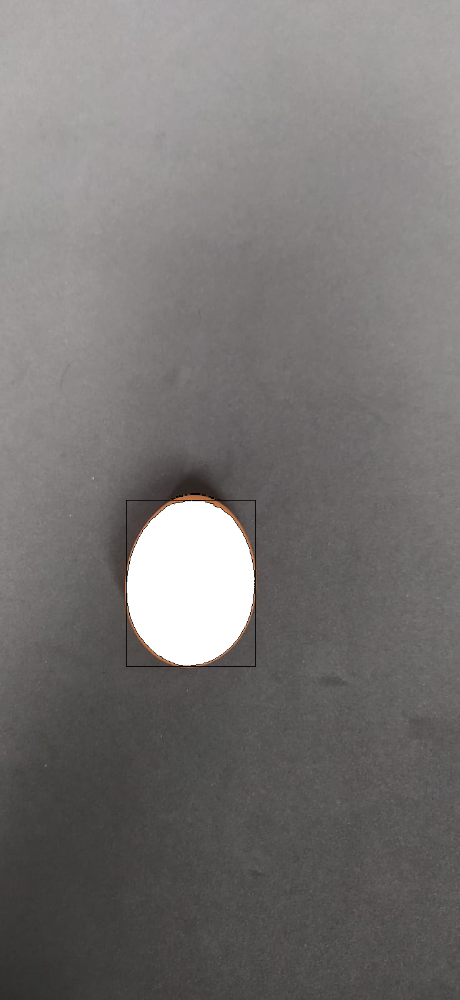

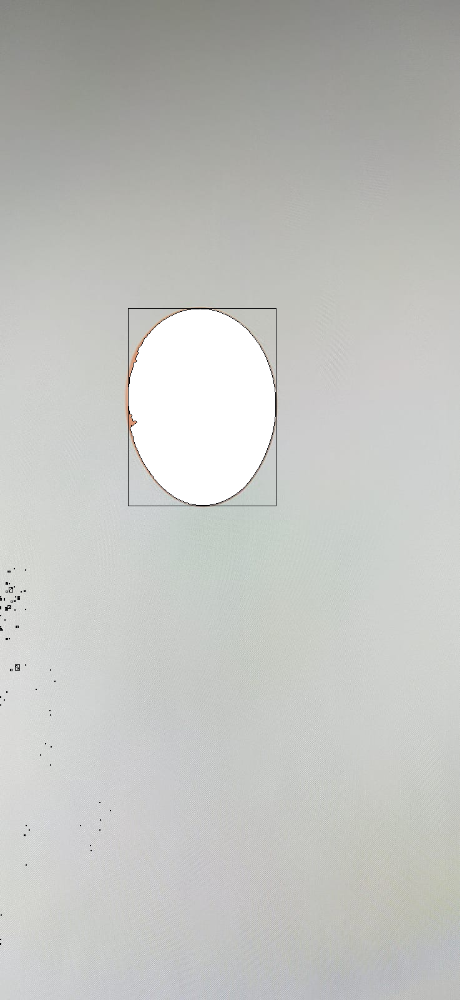

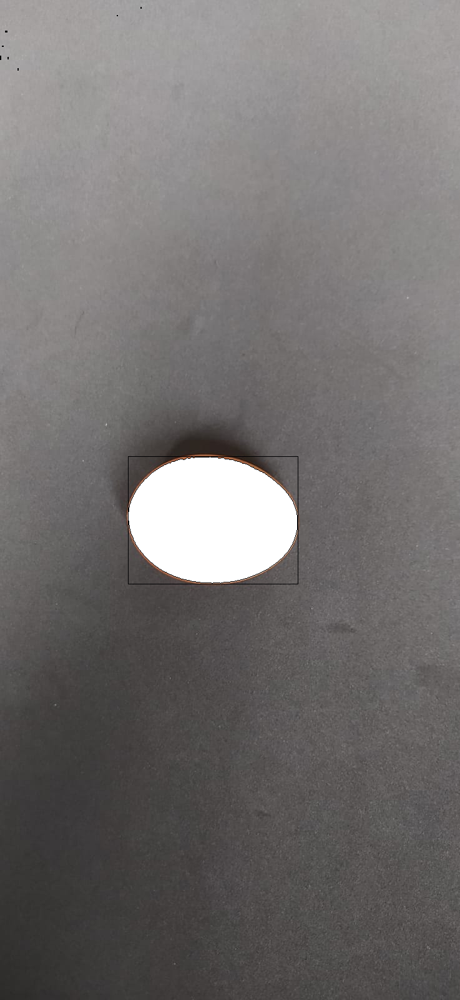

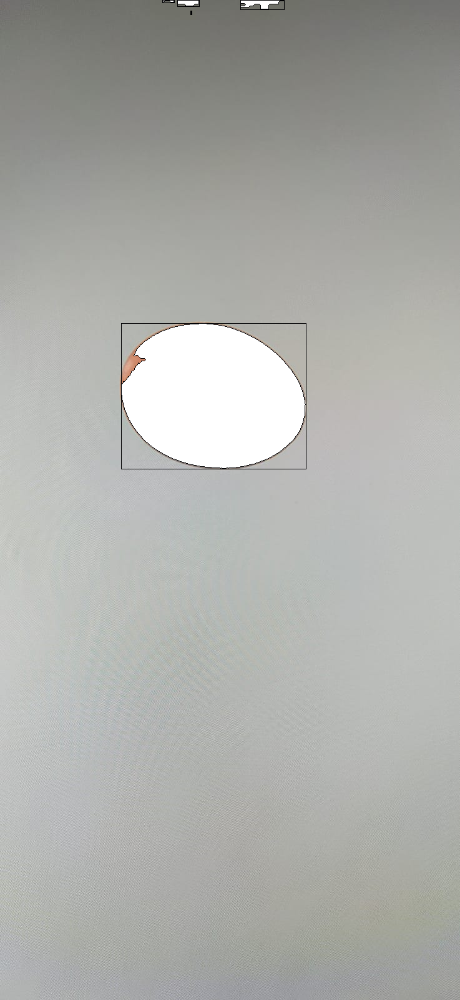

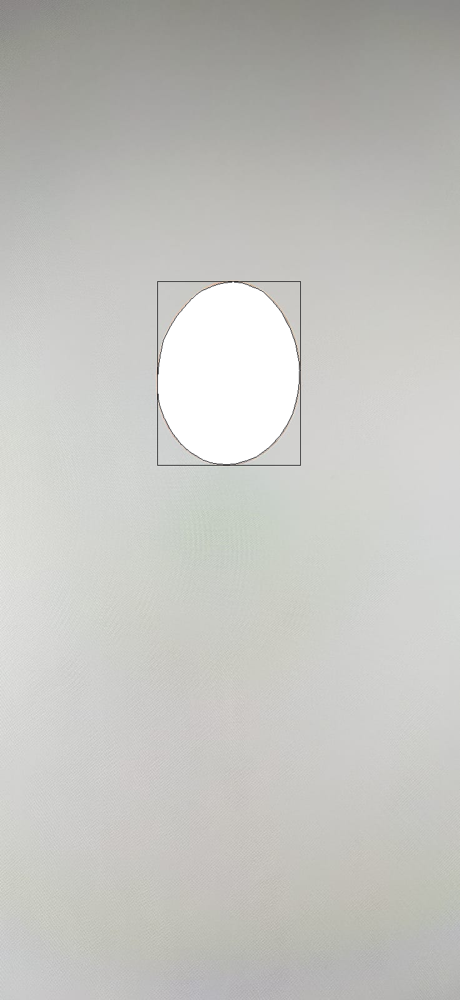

In [10]:
egg01= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/EGG/3-01-V1-B-GT.png')
egg02= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/EGG/3-01-V1-W-GT.png')
egg03= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/EGG/3-01-V2-B-GT.png')
egg04= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/EGG/3-01-V2-W-GT.png')
egg05= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/EGG/3-02-V1-W-GT.png')
gt(egg01, 0, "EGG")
gt(egg02, 1, "EGG")
gt(egg03, 2, "EGG")
gt(egg04, 3, "EGG")
gt(egg05, 4, "EGG")

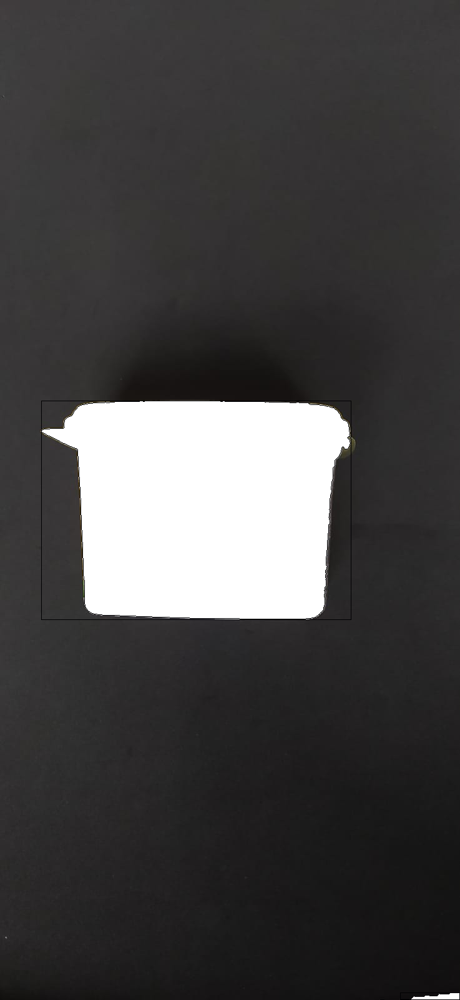

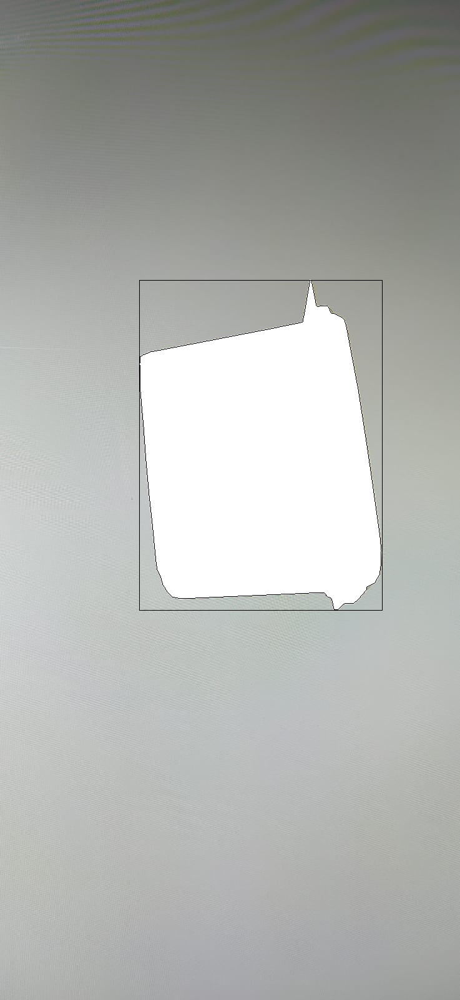

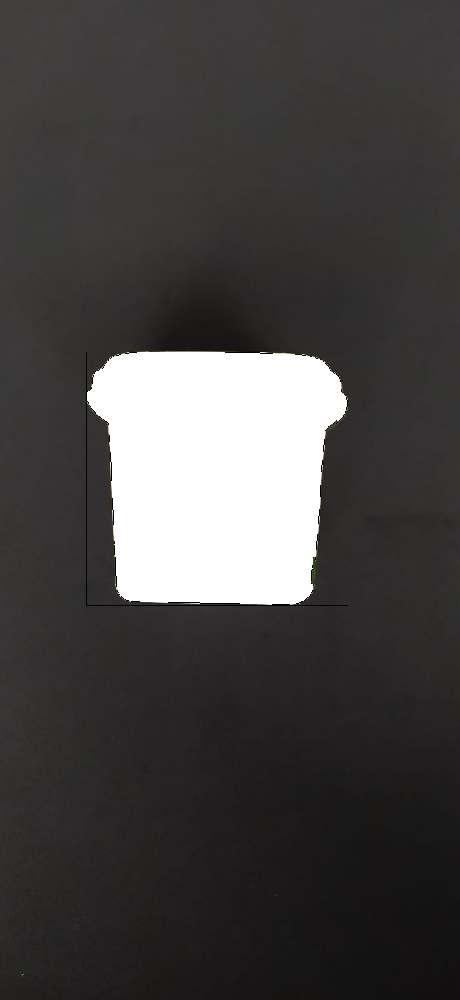

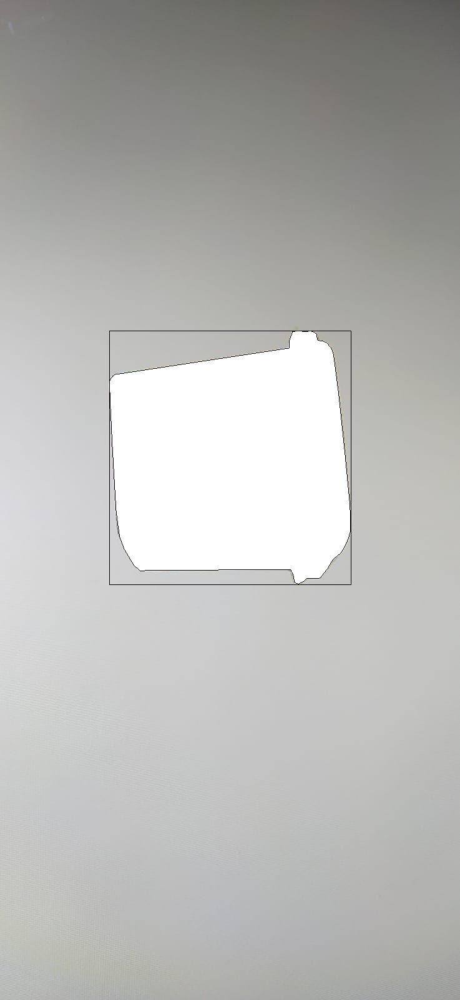

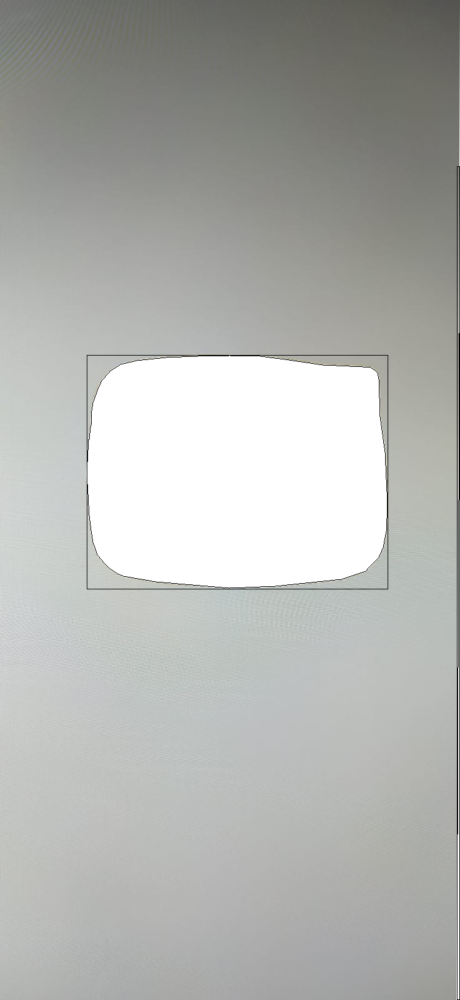

In [11]:
margarine01= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MARGARINE/4-01-V1-B-GT.png')
margarine02= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MARGARINE/4-01-V1-W-GT.png')
margarine03= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MARGARINE/4-01-V2-B-GT.png')
margarine04= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MARGARINE/4-01-V2-W-GT.png')
margarine05= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MARGARINE/4-02-V1-W-GT.png')
gt(margarine01, 0,"MARGARINE" )
gt(margarine02, 1,"MARGARINE")
gt(margarine03, 2,"MARGARINE")
gt(margarine04, 3,"MARGARINE")
gt(margarine05, 4,"MARGARINE")

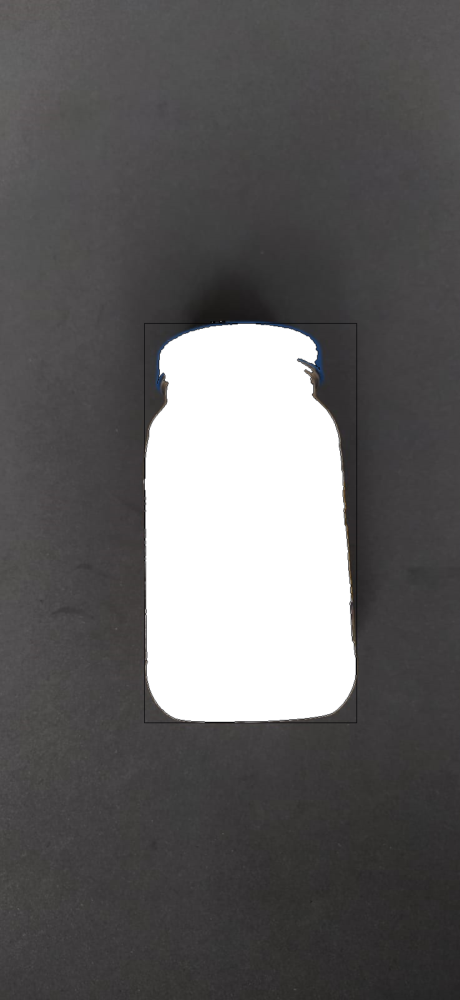

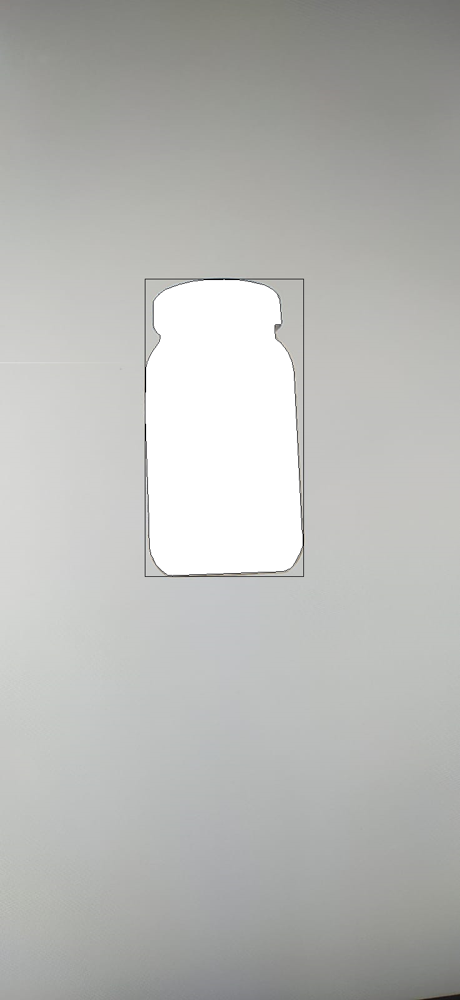

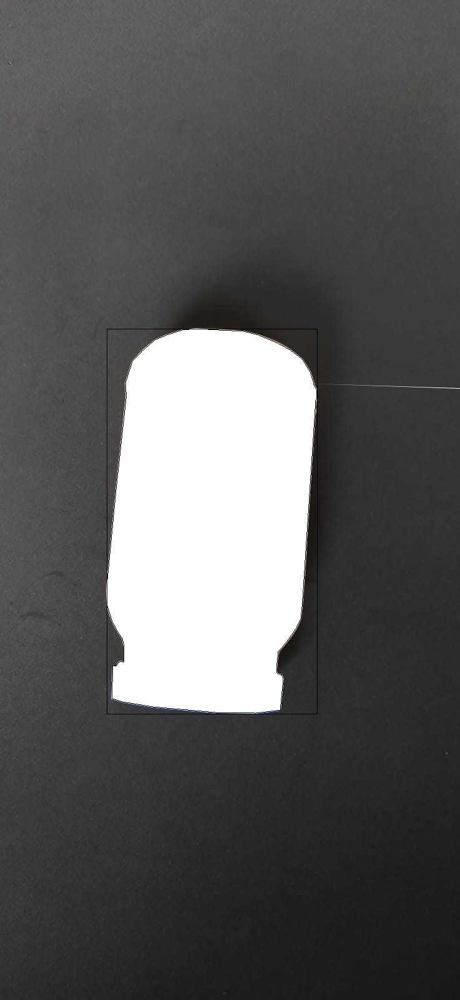

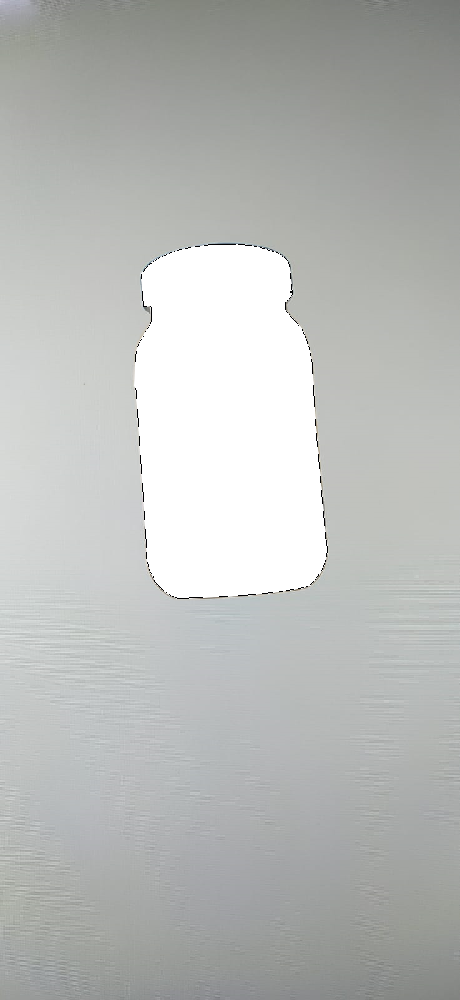

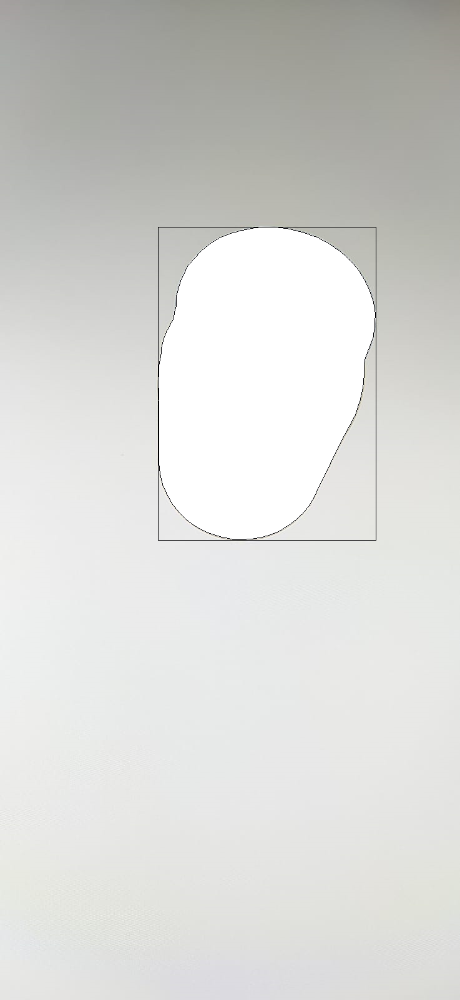

In [12]:
mayonnaise01= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MAYONNAISE/5-01-V1-B-GT.png')
mayonnaise02= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MAYONNAISE/5-01-V1-W-GT.png')
mayonnaise03= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MAYONNAISE/5-01-V2-B-GT.png')
mayonnaise04= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MAYONNAISE/5-01-V2-W-GT.png')
mayonnaise05= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MAYONNAISE/5-02-V1-W-GT.png')
gt(mayonnaise01, 0, "MAYONNAISE")
gt(mayonnaise02, 1, "MAYONNAISE")
gt(mayonnaise03, 2, "MAYONNAISE")
gt(mayonnaise04, 3, "MAYONNAISE")
gt(mayonnaise05, 4, "MAYONNAISE")

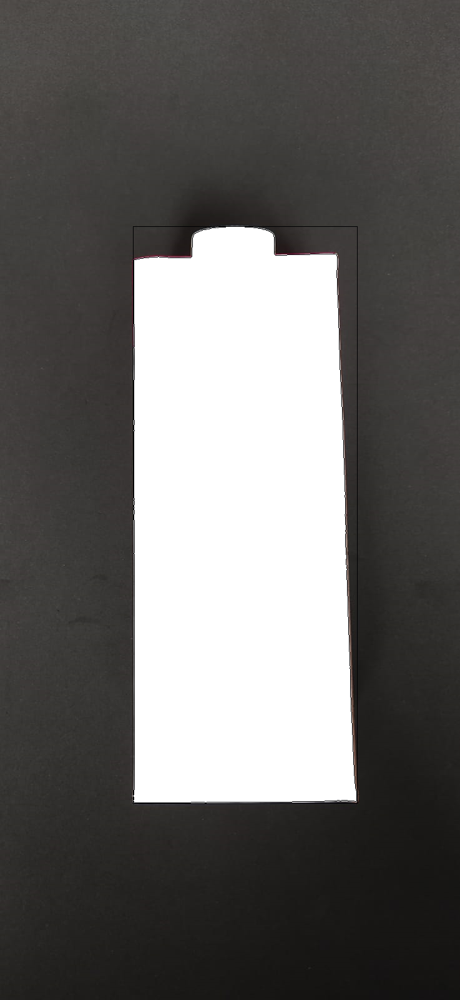

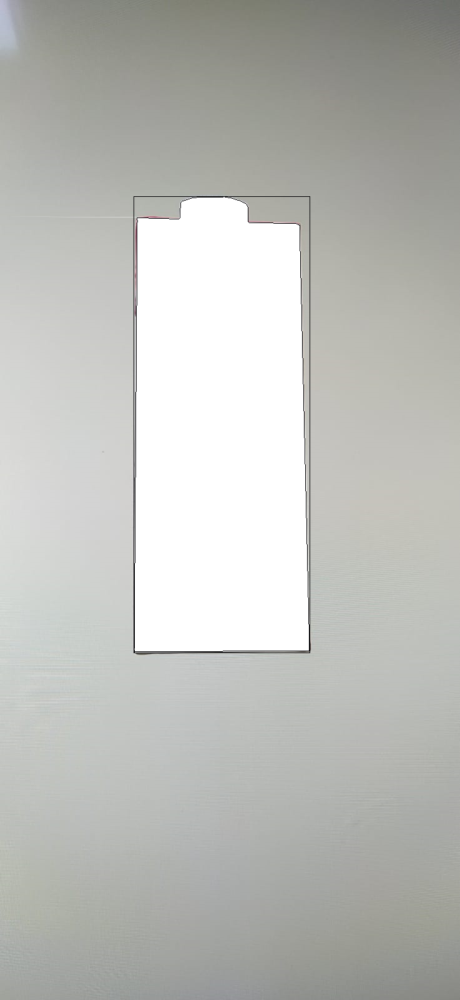

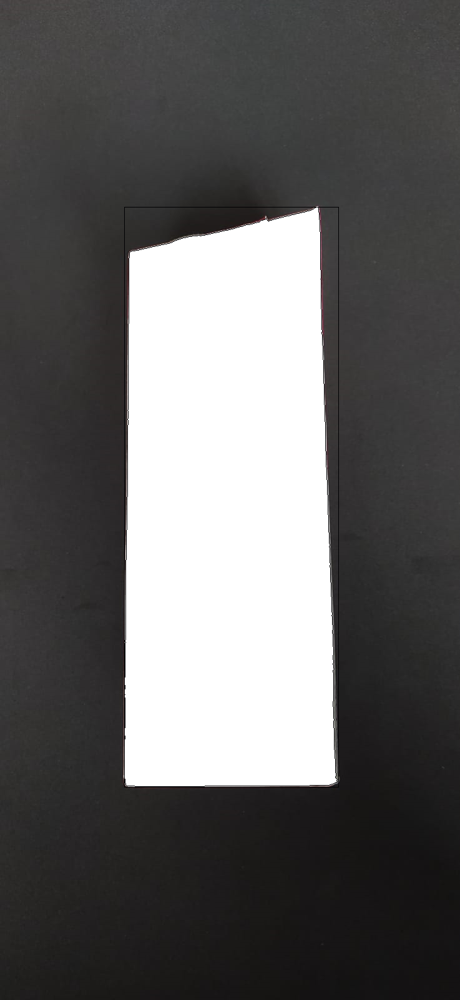

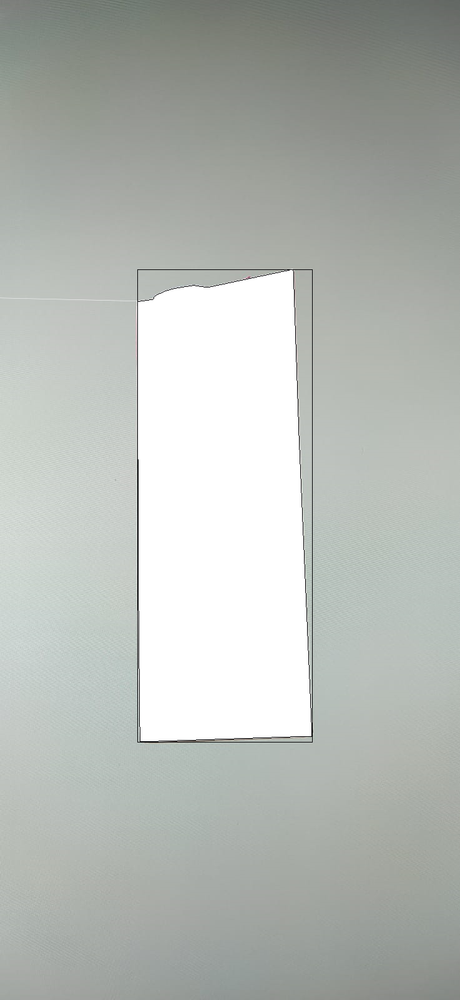

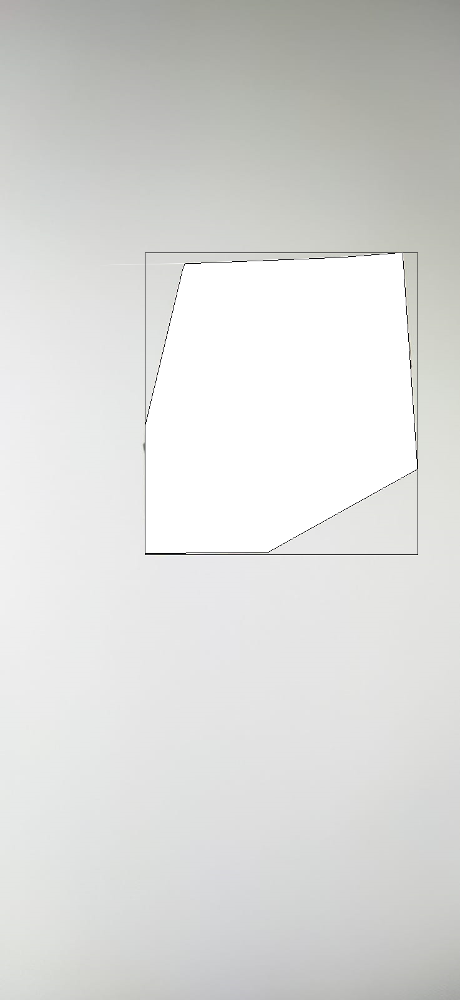

In [13]:
milk01= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MILK/6-01-V1-B-GT.png')
milk02= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MILK/6-01-V1-W-GT.png')
milk03= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MILK/6-01-V2-B-GT.png')
milk04= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MILK/6-01-V2-W-GT.png')
milk05= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/MILK/6-02-V1-W-GT.png')
gt(milk01, 0, "MILK")
gt(milk02, 1, "MILK")
gt(milk03, 2, "MILK")
gt(milk04, 3, "MILK")
gt(milk05, 4, "MILK")

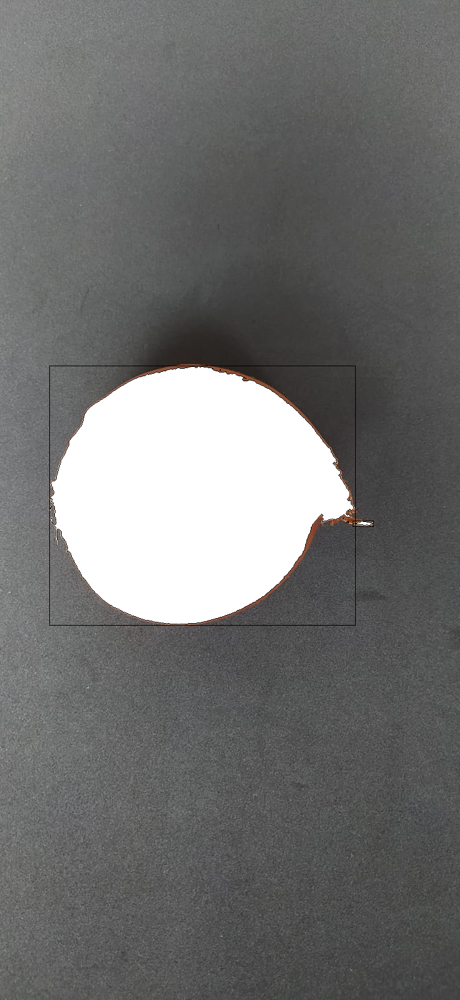

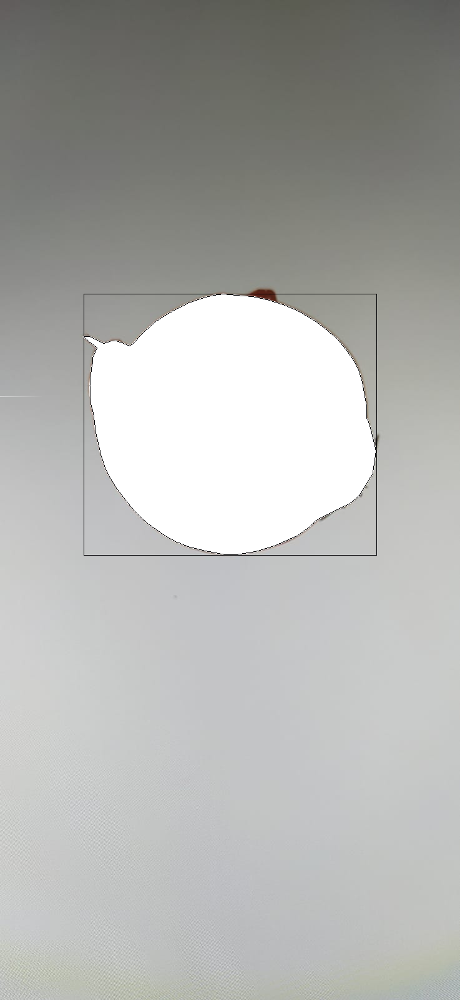

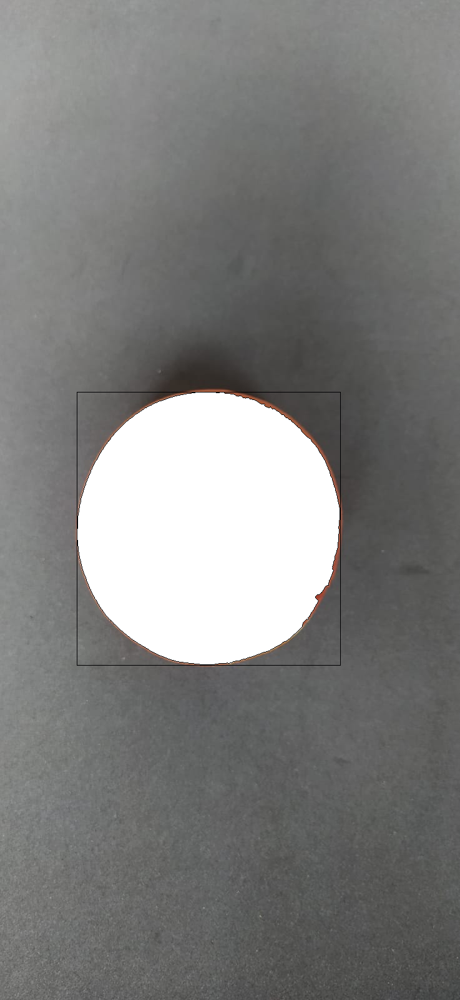

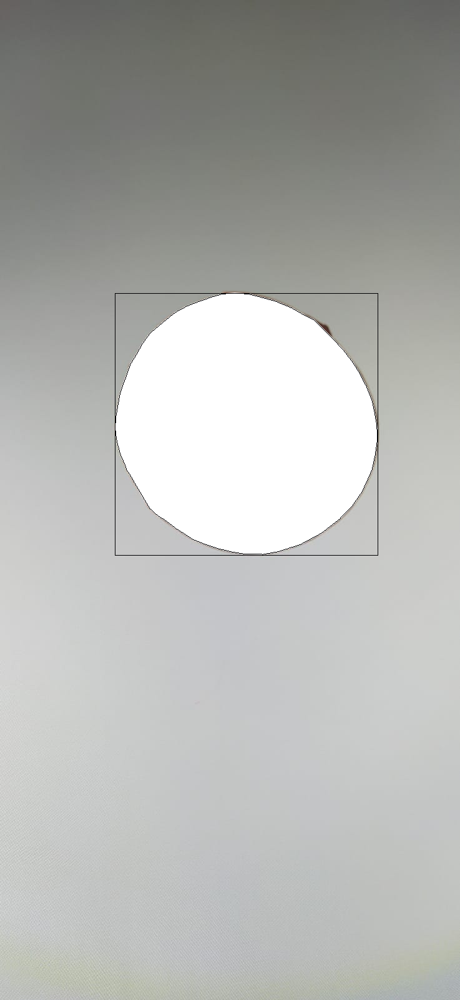

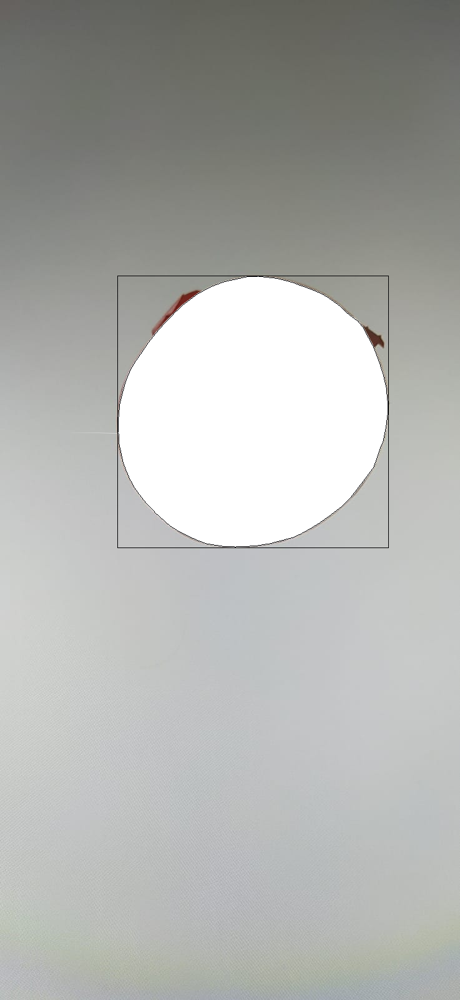

In [14]:
onion01= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/ONION/7-01-V1-B-GT.png')
onion02= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/ONION/7-01-V1-W-GT.png')
onion03= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/ONION/7-01-V2-B-GT.png')
onion04= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/ONION/7-01-V2-W-GT.png')
onion05= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/ONION/7-02-V1-W-GT.png')
gt(onion01, 0, "ONION")
gt(onion02, 1, "ONION")
gt(onion03, 2, "ONION")
gt(onion04, 3, "ONION")
gt(onion05, 4, "ONION")

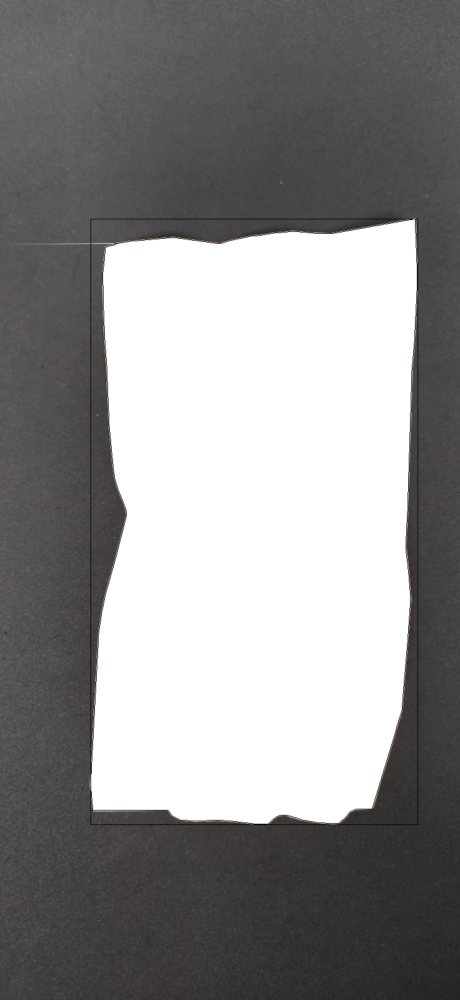

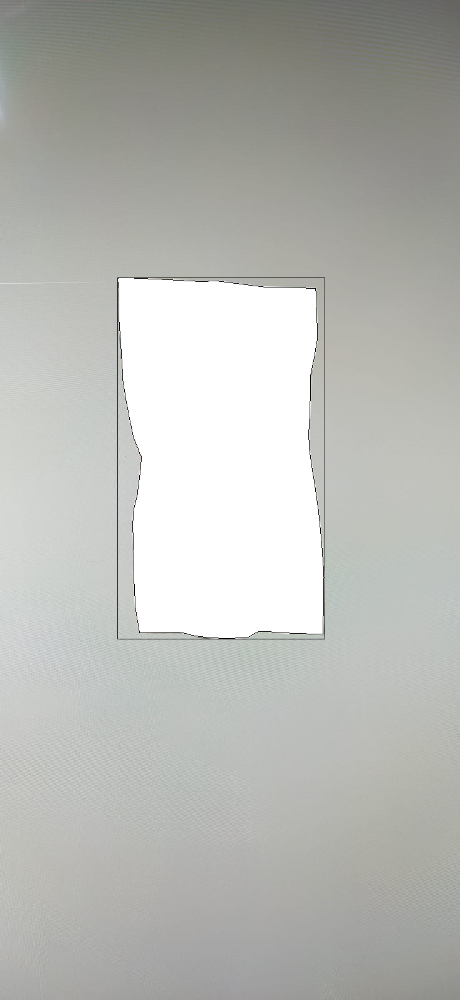

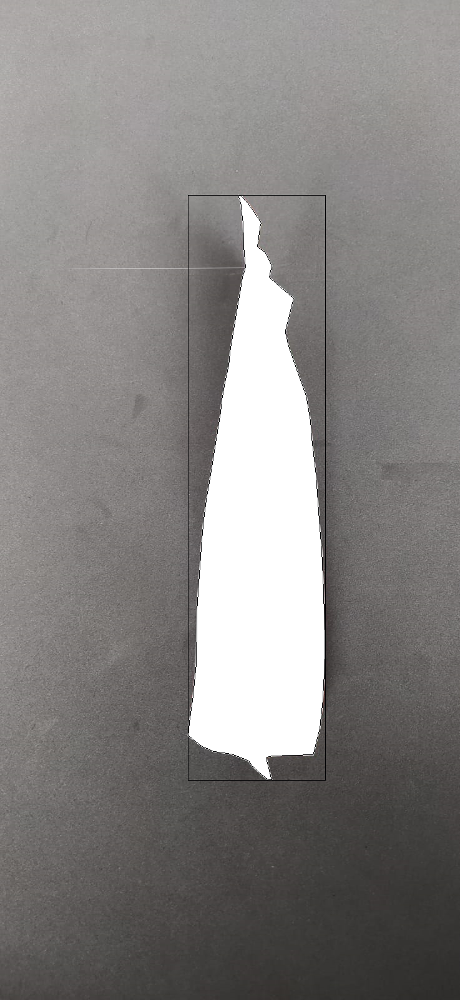

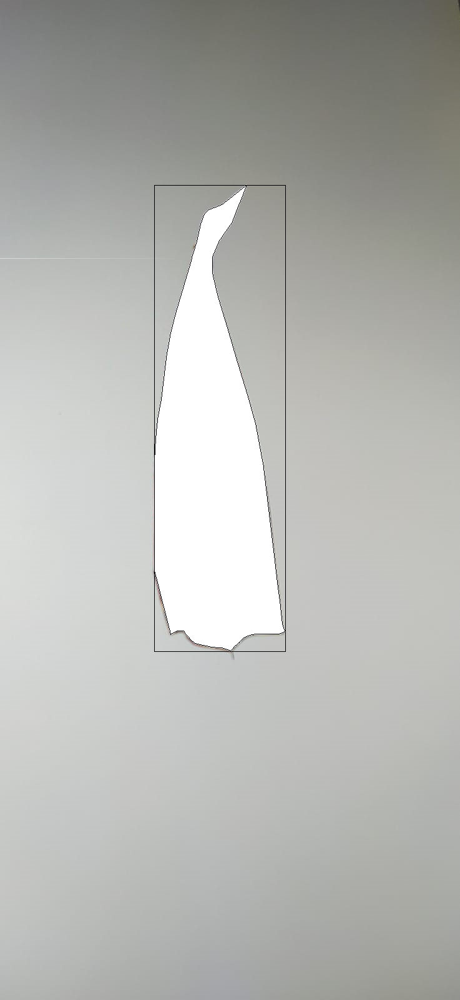

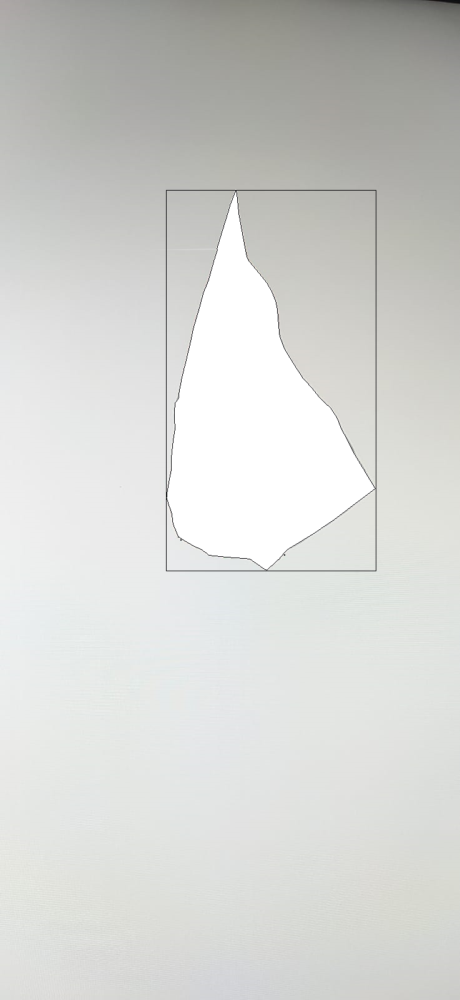

In [15]:
tomato_sauce01= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/TOMATO_SAUCE/8-01-V1-B-GT.png')
tomato_sauce02= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/TOMATO_SAUCE/8-01-V1-W-GT.png')
tomato_sauce03= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/TOMATO_SAUCE/8-01-V2-B-GT.png')
tomato_sauce04= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/TOMATO_SAUCE/8-01-V2-W-GT.png')
tomato_sauce05= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/TOMATO_SAUCE/8-02-V1-W-GT.png')
gt(tomato_sauce01, 0,"TOMATO_SAUCE")
gt(tomato_sauce02, 1,"TOMATO_SAUCE")
gt(tomato_sauce03, 2,"TOMATO_SAUCE")
gt(tomato_sauce04, 3,"TOMATO_SAUCE")
gt(tomato_sauce05, 4,"TOMATO_SAUCE")

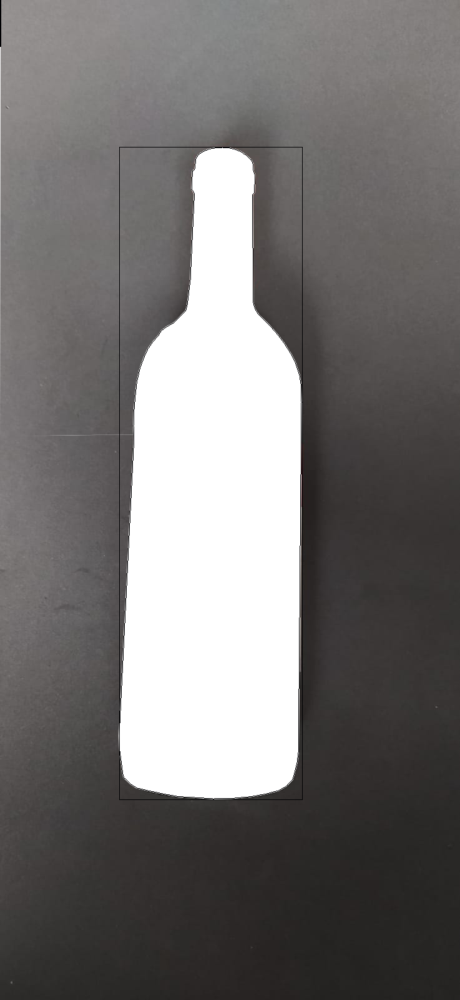

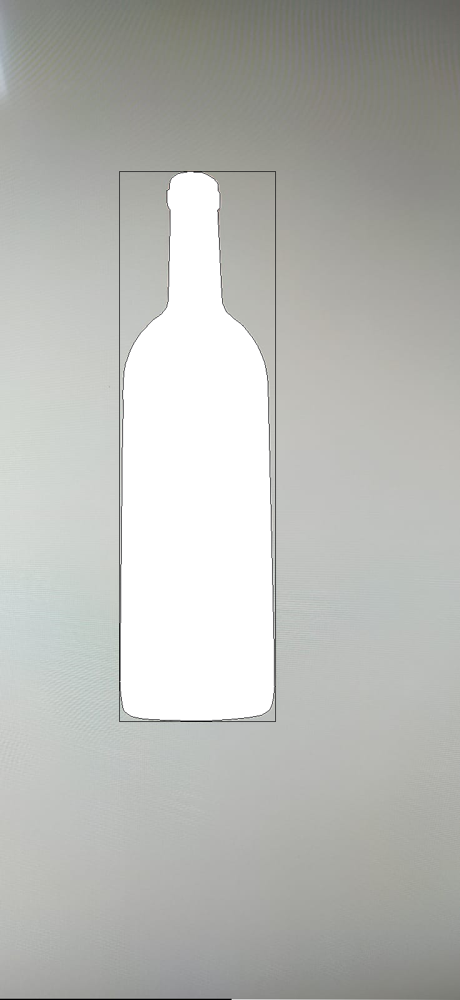

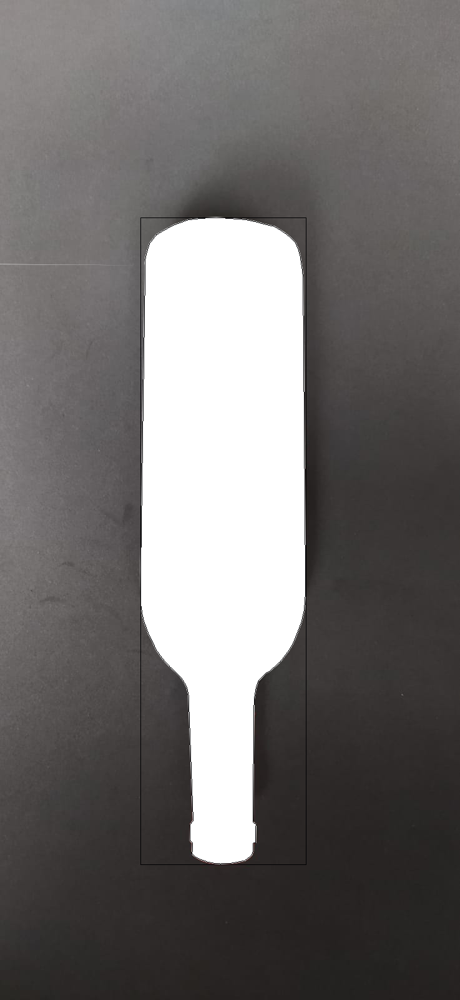

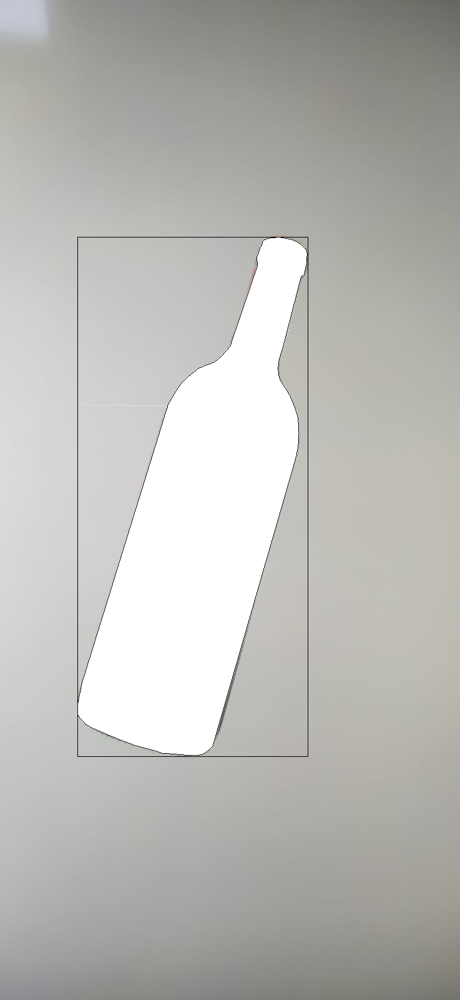

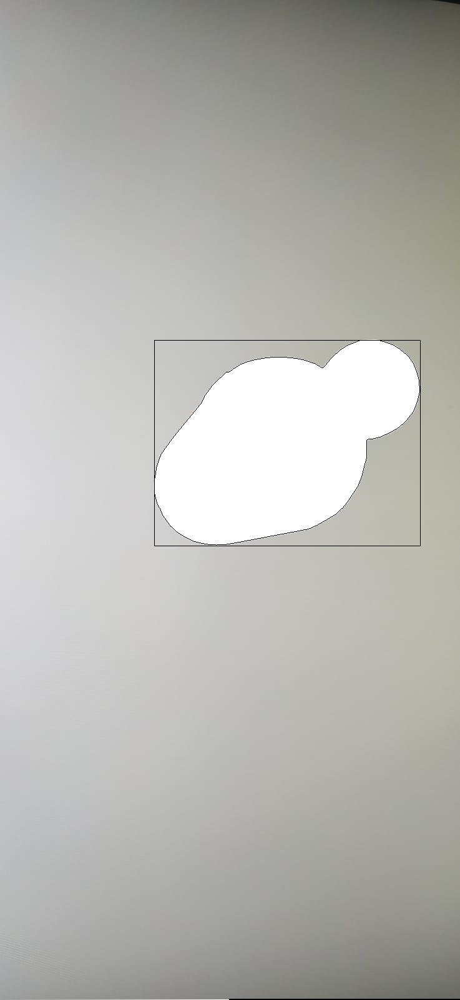

In [16]:
wine01= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/WINE/9-01-V1-B-GT.png')
wine02= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/WINE/9-01-V1-W-GT.png')
wine03= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/WINE/9-01-V2-B-GT.png')
wine04= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/WINE/9-01-V2-W-GT.png')
wine05= cv2.imread('/content/TRABALHO-PDI-GROUND-TRUTH/SEGMENTAÇÃO/WINE/9-02-V1-W-GT.png')
gt(wine01, 0,"WINE")
gt(wine02, 1,"WINE")
gt(wine03, 2,"WINE")
gt(wine04, 3,"WINE")
gt(wine05, 4,"WINE")

##CLASSIFICATION

In [17]:
# Carregar imagens

classes = ['BEER', 'CAROT', 'CORN_CAN', 'EGG', 'MARGARINE', 'MAYONNAISE',
           'MILK', 'ONION', 'TOMATO_SAUCE', 'WINE']

imagens = []
y = []
for i, classe in enumerate(classes):
  pasta = f'/content/DATA_AUGMENTATION/{classe}/*.png'
  imagens_path = glob.glob(pasta)

  for image_path in imagens_path:
    img = cv2.imread(image_path)
    imagens.append(img)
    y.append(i)

x = np.array(imagens)
y = np.array(y)

In [18]:
x = np.reshape(x, (250, 1600*737*3))

In [19]:
from sklearn.model_selection import train_test_split
#dividindo o conjunto de dados em treinamento e teste
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=13)

In [20]:
from sklearn import tree
#treinando a arvore de decisão
clf = tree.DecisionTreeClassifier()
clf = clf.fit(x_train, y_train)

In [21]:
y_pred = clf.predict(x_test)

In [22]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred, target_names=classes))

              precision    recall  f1-score   support

        BEER       0.40      1.00      0.57         2
       CAROT       0.22      1.00      0.36         2
    CORN_CAN       0.25      0.14      0.18         7
         EGG       0.44      0.67      0.53         6
   MARGARINE       1.00      0.40      0.57         5
  MAYONNAISE       0.50      0.25      0.33         4
        MILK       1.00      0.57      0.73         7
       ONION       0.62      0.71      0.67         7
TOMATO_SAUCE       1.00      0.33      0.50         3
        WINE       0.67      0.57      0.62         7

    accuracy                           0.52        50
   macro avg       0.61      0.56      0.51        50
weighted avg       0.63      0.52      0.52        50



Confusion matrix:
[[2 0 0 0 0 0 0 0 0 0]
 [0 2 0 0 0 0 0 0 0 0]
 [0 3 1 3 0 0 0 0 0 0]
 [0 0 1 4 0 0 0 1 0 0]
 [1 1 0 0 2 0 0 0 0 1]
 [0 2 0 0 0 1 0 0 0 1]
 [1 0 1 1 0 0 4 0 0 0]
 [0 0 1 1 0 0 0 5 0 0]
 [0 0 0 0 0 1 0 1 1 0]
 [1 1 0 0 0 0 0 1 0 4]]


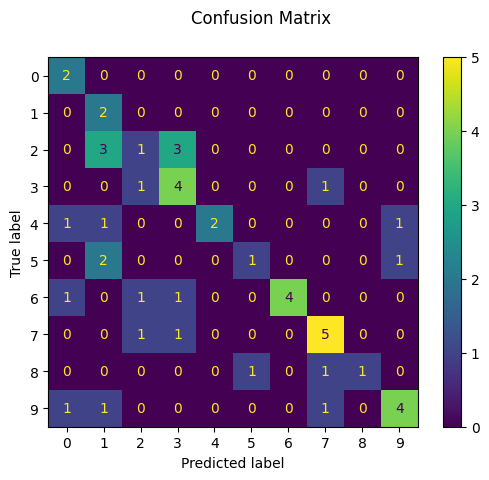

In [23]:
from sklearn import metrics

disp = metrics.ConfusionMatrixDisplay.from_predictions(y_test, y_pred)

disp.figure_.suptitle("Confusion Matrix")

print(f"Confusion matrix:\n{disp.confusion_matrix}")

plt.show()